# Something cool

In [4]:
import h5py
import numpy as np
import cv2
import matplotlib.pyplot as plt
from scipy.io import loadmat
import os
import json
import glob

In [2]:
data_dict = h5py.File('nyu_depth_v2_labeled.mat', 'r')

In [3]:
data_dict.keys()

<KeysViewHDF5 ['#refs#', '#subsystem#', 'accelData', 'depths', 'images', 'instances', 'labels', 'names', 'namesToIds', 'rawDepthFilenames', 'rawDepths', 'rawRgbFilenames', 'sceneTypes', 'scenes']>

In [4]:
an_image = np.transpose(data_dict['images'][0], (2,1,0))
an_image_depth = np.transpose(data_dict['depths'][0], (1,0))
print('image shape is ', an_image.shape, '\ndepth map shape is ', an_image_depth.shape)

image shape is  (480, 640, 3) 
depth map shape is  (480, 640)


In [1]:
data_dict['names'][0][0]

NameError: name 'data_dict' is not defined

## An example image:

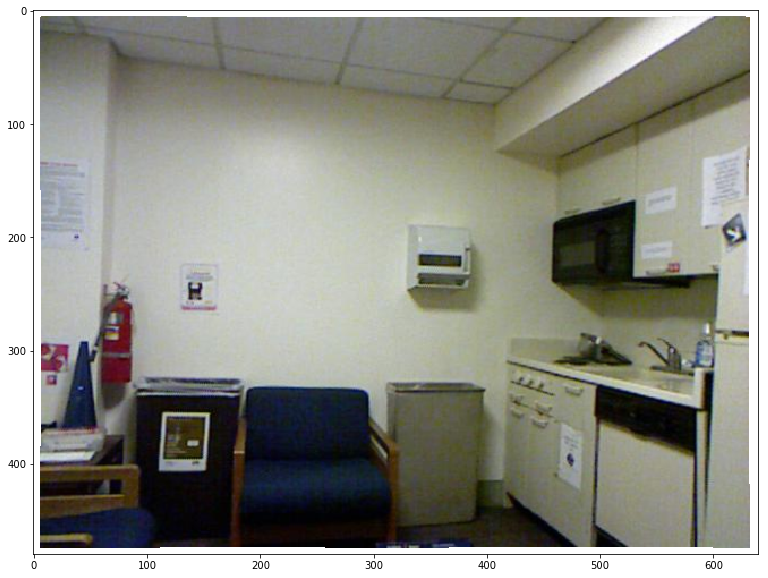

In [6]:
plt.figure(figsize = (40,10))
plt.imshow(an_image)

### With depth map:

In [7]:
np.max(an_image_depth)

3.615639

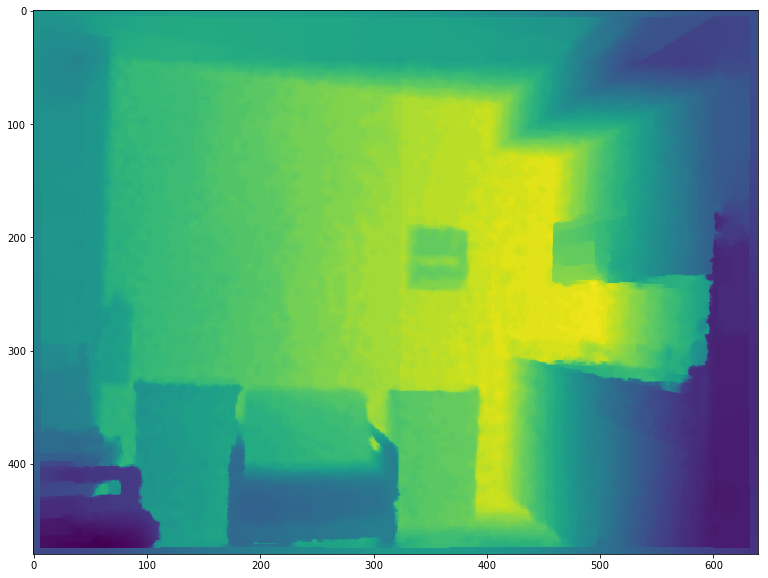

In [8]:
plt.figure(figsize = (40,10))
plt.imshow(an_image_depth)

In [9]:
data_dict['labels'][0].shape

(640, 480)

In [10]:
data_dict['namesToIds'][0]

array([3707764736,          2,          1,          1,          1,
                1], dtype=uint32)

In [11]:
data_dict['instances'][0].shape

(640, 480)

In [12]:
np.max(data_dict['instances'][0])

5

### We can see the segmentation below
The segmentation maps consist of:
   - Object (class) map
   - Instance map

Object class map:

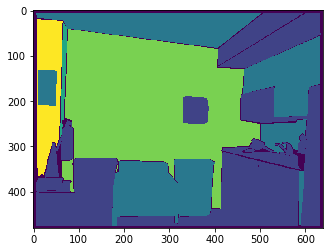

In [13]:
# Create figure and axes
fig, ax = plt.subplots()

# Display the image
ax.imshow(np.transpose(data_dict['instances'][0], (1,0)))

Instance map:

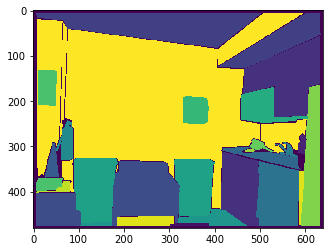

In [14]:
# Create figure and axes
fig, ax = plt.subplots()

# Display the image
ax.imshow(np.transpose(data_dict['labels'][0], (1,0)))

In [15]:
imgObjectLabels = data_dict['labels'][0]
imgInstances = data_dict['instances'][0]

### Getting the segmentation for individual objects:
This is modelled similar to get_instance_masks(imgObjectLabels, imgInstances) from the dataset documentation. 

The segmentation 'object' and 'image' masks consist of objects in the image. 
They consist of enumerated labels 0,1,2...
(The first label 0 means there is no object).

An 'object' here includes any object of a specific type. 
For example, all chairs in an image will be masked with the same value in the object mask. 

An 'instance' includes the sub-object within an object class. 
For example, the first chair in the image will have the label 1, but the first table will also have the label 1.

We need to combine these to get all the objects. 

In [16]:
#size of the image
H, W = imgObjectLabels.shape

#Shaping our dimensions, so that we can put the instance and object labels 'beside' each other
imgObjectLabelsExpDim = np.expand_dims(imgObjectLabels, axis=2)
imgInstancesExpDim = np.expand_dims(imgInstances, axis=2)

#Concatenate the object labels with the instance labels. 
#Each 'pixel' will have both a value for the object and instance. (shape of (W, H, 2))
imgObjectAndInstances = np.concatenate([imgObjectLabelsExpDim, imgInstancesExpDim], axis=2)
imgObjectAndInstances = imgObjectAndInstances.reshape(-1, 2)

#unique combinations of object and instance to get all the individual object (labels)
pairs = np.unique(imgObjectAndInstances, axis = 0)
N = pairs.shape[0]

#prepare the masks where we will get the mask for each instance of object
instanceMasks = np.zeros((H, W, N))
instanceLabels = np.zeros((N, 1))
for i in range(N):
    imgObjectLabelsTruth = np.where(imgObjectLabels == pairs[i,0], 1, 0)
    imgInstancesTruth = np.where(imgInstances == pairs[i,1], 1, 0)
    
    instanceMasks[:,:,i] = np.where(imgObjectLabelsTruth & imgInstancesTruth, 1, 0)
    instanceLabels[i] = pairs[i,0]

In [17]:
instanceMasksReshape = np.transpose(instanceMasks,(2,1,0))

In [18]:
eg_obj_idx = 20

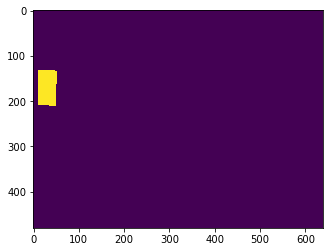

In [19]:
# Create figure and axes
fig, ax = plt.subplots()

# Display the image
ax.imshow(instanceMasksReshape[eg_obj_idx])

### Now we can extract the part of the image with this mask from the depth map and the original image:

In [20]:
def plotMask(image, obj_index):
    try:
        if image.shape[2] == 3:
            condition = instanceMasksReshape[obj_index].reshape(*instanceMasksReshape.shape[1:3], 1)
    except:
        condition = instanceMasksReshape[obj_index]
    
    
    thing = np.where(condition, image, np.zeros(image.shape, dtype=int))

    # Create figure and axes
    fig, ax = plt.subplots()

    # Display the image
    ax.imshow(thing)

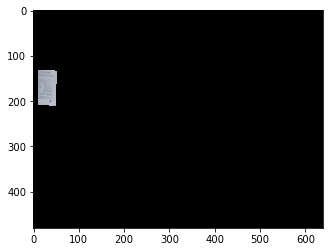

In [21]:
plotMask(an_image, eg_obj_idx)

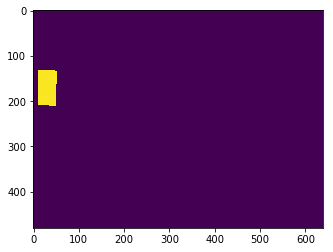

In [22]:
plotMask(an_image_depth, eg_obj_idx)

In [23]:
condition = instanceMasksReshape[eg_obj_idx]
#thing = np.where(condition, an_image_depth, np.zeros(an_image_depth.shape, dtype=int))

In [24]:
points_to_plot = list()
indices = np.nonzero(condition)
for i in range(len(indices[0])):
    points_to_plot.append([indices[0][i], indices[1][i], an_image_depth[indices[0][i], indices[1][i]]])
points_to_plot = np.asarray(points_to_plot)

In [25]:
points_to_plot.shape

(3167, 3)

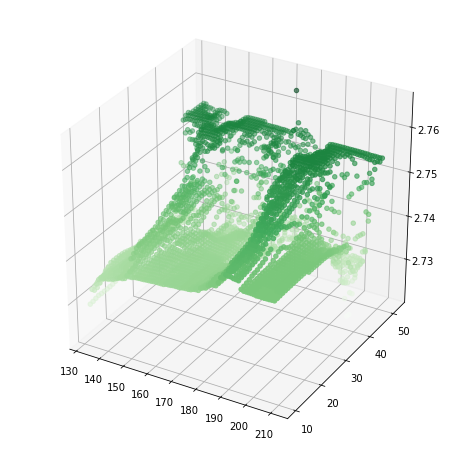

In [26]:
# importing required libraries
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt

fig = plt.figure(figsize=(8,8))

ax = fig.add_subplot(111, projection='3d')

x_data = points_to_plot[:,0]
y_data = points_to_plot[:,1]
z_data = points_to_plot[:,2]

ax.scatter3D(x_data, y_data, z_data, c=z_data, cmap='Greens');
plt.show()

In [27]:
import pandas as pd
import plotly.graph_objects as go
import plotly.express as px
df = pd.DataFrame(data=points_to_plot, columns=['x','y','z'])
fig = px.scatter_3d(df, x='x', y='y', z='z')
fig.show()

In [28]:
import plotly.graph_objects as go
import pandas as pd

surface = np.zeros(an_image_depth.shape)
surface[indices] = an_image_depth[indices]
surface = an_image_depth
df = pd.DataFrame(data=surface)
#z_data = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/api_docs/mt_bruno_elevation.csv')

fig = go.Figure(data=[go.Surface(z=df.values)])

fig.update_layout(title='Depth map', autosize=True,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))

fig.show()

## The Sentences dataset tests:

In [29]:
from mat4py import loadmat

data1 = loadmat('SentencesNYUv2_toolbox/data/scene_classes.mat')
data2 = loadmat('SentencesNYUv2_toolbox/data/classes_final.mat')
data3 = loadmat('SentencesNYUv2_toolbox/data/myimages.mat')
#something = h5py.File('SentencesNYUv2_toolbox/data/scene_classes.mat', 'r')

In [30]:
data2.keys()

dict_keys(['removed_names', 'in_final', 'classes', 'reduced_to_final', 'final_to_reduced'])

In [31]:
data2['removed_names']

['floor',
 'ceil',
 'wall',
 'door',
 'window',
 'picture',
 'chandelier',
 'trash_can',
 'stool',
 'stove',
 'background']

In [32]:
mat = loadmat('SentencesNYUv2_toolbox/data/descriptions_gt/gt0001.mat')

In [33]:
data1

{'classes': ['kitchen',
  'office',
  'bathroom',
  'living_room',
  'bedroom',
  'bookstore',
  'classroom',
  'home_office',
  'playroom',
  'reception_room',
  'study',
  'dining_room',
  'other'],
 'class_labels': [[1],
  [1],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [2],
  [3],
  [3],
  [3],
  [3],
  [3],
  [3],
  [4],
  [4],
  [4],
  [4],
  [4],
  [4],
  [5],
  [5],
  [5],
  [5],
  [5],
  [5],
  [5],
  [5],
  [5],
  [5],
  [5],
  [5],
  [5],
  [5],
  [5],
  [5],
  [5],
  [5],
  [5],
  [5],
  [5],
  [5],
  [5],
  [5],
  [5],
  [5],
  [5],
  [5],
  [6],
  [6],
  [6],
  [6],
  [6],
  [6],
  [6],
  [6],
  [6],
  [6],
  [6],
  [6],
  [6],
  [6],
  [6],
  [6],
  [6],
  [6],
  [6],
  [6],
  [6],
  [6],
  [6],
  [6],
  [6],
  [6],
  [6],
  [6],
  [6],

In [34]:
mat = loadmat('SentencesNYUv2_toolbox/data/descriptions/0001.mat')
#mat = array=np.asarray(loadmat('SentencesNYUv2_toolbox/data/descriptions/0001.mat'))

In [35]:
#mat['annotation'][0][0]
mat.keys()

dict_keys(['__header__', '__version__', '__globals__', 'annotation'])

In [36]:
annotations = np.asarray(mat['annotation'])

In [37]:
for i in annotations[0][0]:
    print(i.shape)

(1,)
(1, 3)
(31, 4)
(1, 31)
(1, 1)
(31, 1)
(31, 1)
(0, 0)


In [38]:
annotations[0][0][6][0]

array([(array(['notlabeled'], dtype='<U10'), array([[0]], dtype=uint8))],
      dtype=[('name', 'O'), ('difficult', 'O')])

In [39]:
swag = np.zeros(an_image.shape[:2])
a=0
for i in annotations[0][0][3][5]:
    swag[i[1]][i[0]] = 1

IndexError: index 5 is out of bounds for axis 0 with size 1

In [51]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image

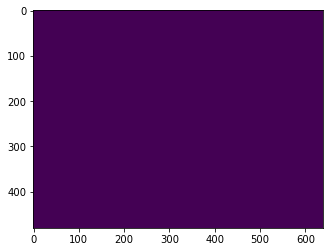

In [52]:
# Create figure and axes
fig, ax = plt.subplots()

# Display the image
ax.imshow(swag)

In [53]:
len(annotations[0][0][2])

31

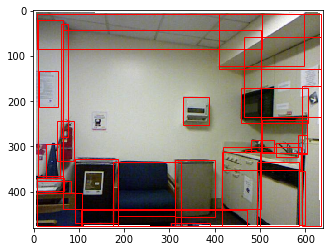

In [54]:

# Create figure and axes
fig, ax = plt.subplots()

# Display the image
ax.imshow(an_image)

for thing in annotations[0][0][2]:
    # Create a Rectangle patch
    rect = patches.Rectangle((thing[0], thing[1]),  thing[2],  thing[3], linewidth=1, edgecolor='r', facecolor='none')
    # Add the patch to the Axes
    ax.add_patch(rect)

plt.show()

In [158]:
from transformers import DetrFeatureExtractor, DetrForObjectDetection
from PIL import Image
import requests

url = 'http://images.cocodataset.org/val2017/000000039769.jpg'
image = Image.open(requests.get(url, stream=True).raw)

feature_extractor = DetrFeatureExtractor.from_pretrained('facebook/detr-resnet-101')
model = DetrForObjectDetection.from_pretrained('facebook/detr-resnet-101')

inputs = feature_extractor(images=an_image, return_tensors="pt")
outputs = model(**inputs)

# model predicts bounding boxes and corresponding COCO classes
logits = outputs.logits
bboxes = outputs.pred_boxes

In [170]:
target_sizes = torch.tensor(image.size[::-1]).unsqueeze(0)
postprocessed_outputs = feature_extractor.post_process(outputs, target_sizes)
bboxes_scaled = postprocessed_outputs[0]['boxes'][:10]

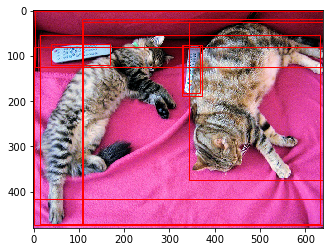

In [171]:
# Create figure and axes
fig, ax = plt.subplots()

# Display the image
ax.imshow(image)

for xmin, ymin, xmax, ymax in bboxes_scaled.tolist():
    # Create a Rectangle patch
    rect = patches.Rectangle((xmin, ymin),  xmax-xmin,  ymax-ymin, linewidth=1, edgecolor='r', facecolor='none')
    # Add the patch to the Axes
    ax.add_patch(rect)

plt.show()

intersection over union, bouding boxes to annotations/3d objects (IOU)
faster r-cnn to identify the boxes, then get the depth using the IOU
faster r-cnn might include some kind of 3d magic? Probebly not

what is the most effective way of mapping between the objects

visual vs. geometry
what am i doing

we incorporate stuff either as geometry features or as ...something else? visual/bert?
segment vs. position vs. input?
mmbt

boxrelationalembedding/encoding?

train/fine tune on the new data set. 

# Annotations

The structure of the annotations file is:

FILE:
    'images' (list of dicts)
        'sentids' (list of numerals, enumerated ints, all sentences)
        'imgid' (int)
        'sentences' (list of dicts)
            'tokens' (list of tokens)
            'raw' (full string)
            'imageid' (int, same/matching as above ids)
            'sentid' (int, same/matching as above ids)
        'split' (str, 'train', 'test', whatever)
        'filepath'
        'cocoid' (int)
        'filename' (str, blahblah.jpg)
    'dataset' ('str', name of dataset)

In [3]:
thing1 = loadmat('SentencesNYUv2_toolbox/data/descriptions/0001.mat')
thing2 = loadmat('SentencesNYUv2_toolbox/data/descriptions_gt/gt0001.mat')

In [26]:
json_boi = dict()
json_boi['dataset'] = "SentencesNYUv2"
json_boi['images'] = list()

imgs_len = len(glob.glob1('SentencesNYUv2_toolbox/data/descriptions_info/',"*.mat"))
train_percent = 0.7
val_percent = 0.15

train_ = ['train' for i in range(int(imgs_len*train_percent))]
val_ = ['val' for i in range(int(imgs_len*val_percent))]
test_ = ['test' for i in range(imgs_len-len(train_)-len(val_))]
tvt_split = train_ + val_ + test_

sentid = 0
for i, filename in enumerate(glob.glob1('SentencesNYUv2_toolbox/data/descriptions_info/',"*.mat")):
    imgid = int(filename.strip('.mat').strip('in'))

    append_item = dict()
    append_item['sentids'] = list()
    append_item['imgid'] = imgid
    append_item['sentences'] = list()
    append_item['split'] = tvt_split[i]
    append_item['filepath'] = '../SentencesNYUv2_toolbox/data/images'
    append_item['filename'] = str(imgid).zfill(4) + '.jpg'
    append_item['cocoid'] = imgid
    append_item['id'] = imgid

    image_descriptions = loadmat(f'SentencesNYUv2_toolbox/data/descriptions_info/in{str(imgid).zfill(4)}.mat')['descriptions'][0]
    sentences_list = [thing.strip(' ')+'.' for thing in image_descriptions[0][0][0].split('.')][:-1]


    for sent_num in range(5):
        sent_idx = sent_num % len(sentences_list)

        sentence_dict = dict()
        sentence = sentences_list[sent_idx]

        sentence_dict['tokens'] = sentence.strip('.').split(' ')
        sentence_dict['raw'] = sentence
        sentence_dict['imageid'] = imgid
        sentence_dict['sentid'] = sentid

        append_item['sentences'].append(sentence_dict)

        append_item['sentids'].append(sentid)
        sentid += 1

    json_boi['images'].append(append_item)
            
with open('object_relation_transformer/data/dataset_annotations.json', 'w') as f:
    json.dump(json_boi, f)
    

In [51]:
json_boi

{'dataset': 'SentencesNYUv2',
 'images': [{'sentids': [0, 1, 2, 3, 4],
   'imgid': 1,
   'sentences': [{'tokens': ['This',
      'kitchen',
      'has',
      'white',
      'cabinets',
      'and',
      'two',
      'blue',
      'chairs'],
     'raw': 'This kitchen has white cabinets and two blue chairs.',
     'imageid': 1,
     'sentid': 0},
    {'tokens': ['The', 'upper', 'cabinet', 'has', 'a', 'black', 'microwave'],
     'raw': 'The upper cabinet has a black microwave.',
     'imageid': 1,
     'sentid': 1},
    {'tokens': ['The',
      'paper',
      'towels',
      'are',
      'above',
      'the',
      'trash',
      'can'],
     'raw': 'The paper towels are above the trash can.',
     'imageid': 1,
     'sentid': 2},
    {'tokens': ['There',
      'is',
      'a',
      'black',
      'garbage',
      'can',
      'just',
      'on',
      'the',
      'left',
      'of',
      'the',
      'blue',
      'chair'],
     'raw': 'There is a black garbage can just on the left 

In [5]:
image_descriptions = loadmat('SentencesNYUv2_toolbox/data/descriptions_info/in0001.mat')['descriptions'][0]

In [8]:
image_descriptions[0]

(array(['This kitchen has white cabinets and two blue chairs. The upper cabinet has a black microwave. The paper towels are above the trash can. There is a black garbage can just on the left of the blue chair. On its left there is a red fire distinguisher.'],
      dtype='<U247'), array([[array(['This'], dtype='<U4'), array(['kitchen'], dtype='<U7'),
        array(['has'], dtype='<U3'), array(['white'], dtype='<U5'),
        array(['cabinets'], dtype='<U8'), array(['and'], dtype='<U3'),
        array(['two'], dtype='<U3'), array(['blue'], dtype='<U4'),
        array(['chairs'], dtype='<U6'), array(['The'], dtype='<U3'),
        array(['upper'], dtype='<U5'), array(['cabinet'], dtype='<U7'),
        array(['has'], dtype='<U3'), array(['a'], dtype='<U1'),
        array(['black'], dtype='<U5'), array(['microwave'], dtype='<U9'),
        array(['The'], dtype='<U3'), array(['paper'], dtype='<U5'),
        array(['towels'], dtype='<U6'), array(['are'], dtype='<U3'),
        array(['above'], 

In [27]:
annFile = 'object_relation_transformer/data/dataset_annotations.json'
from pycocotools.coco import COCO

In [30]:
coco = COCO(annFile)

loading annotations into memory...
Done (t=0.17s)
creating index...
index created!


In [31]:
valids = coco.getImgIds()